# Frailejon Detection (a.k.a "Big Monks Detection")


En este cuadernos continuaremos con nuestra aproximación a las redes neuronales de la mano con la clasificación de imagenes.

Usted debe construir una red neuronal para detectar automáticamente plantas nativas (frailejones) sobre imagenes aerea páramo de Chingaza y Cruz Verde.

**Business Problem Framming**: Este caso de estudio hace parte de un proyecto de Ingeniería que busca preservar y monitorizar el ecosistema del páramo, de gran importancia por su potencial hídrico, mediante la propuesta de una metodología para la reconstrucción del ecosistema en zonas de baja densidad de poblaciones de la especia _Espeletia_.

## Data
Input:

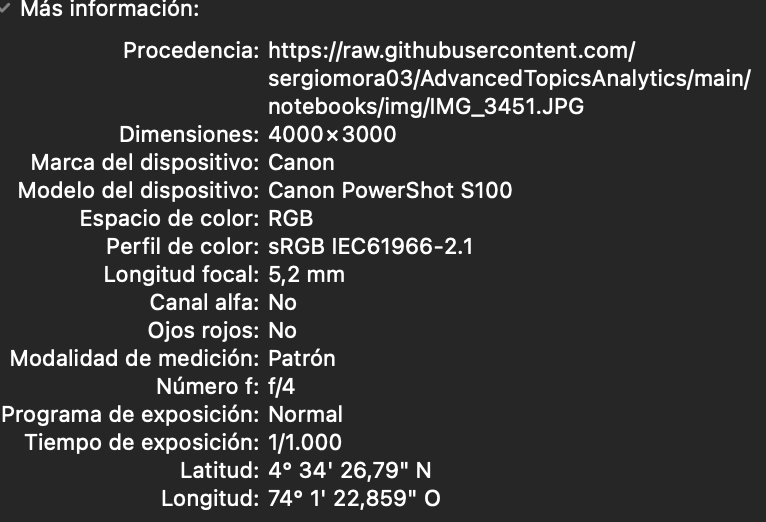

Output:
1. probability that it is a Big Monk.
2. Calculate Big Monks density

## Evaluation

- 30% Report with all the details of the solution, the analysis and the conclusions. The report cannot exceed 10 pages, must be send in PDF format and must be self-contained.
- 30% Code with the data processing and models developed that support the reported results.
- 30% Presentation of no more than 15 minutes with the main results of the project.
- 10% Model performance achieved. Metric: "AUC".


## Requirements

- The project must be carried out in groups of 4 people.
- Use clear and rigorous procedures.
- The delivery of the project is on September 6th, 2024, 11:59 pm, through email with Github link.
- No projects will be received after the delivery time or by any other means than the one established.

## Suggestions

* Use an hyperparameter optimization framework, you can also make grid optimziation or bayesian optimization. Bonus with use:  [Optuna - A hyperparameter optimization framework](https://optuna.org/)
* Remember cualitative analysis with validation image: `IMG_3451.JPG`
* Estimate density for each Big Monks population detected. Bonus with: [Gaussian Mixture Models](https://nbviewer.jupyter.org/github/sergiomora03/Gaussian_Mixture_Models/blob/master/intro_to_gmm_%26_em.ipynb)

## Acknowledgements
We thank Professor Camilo Franco, Ph.D.

In [2]:
%pip install livelossplot
%pip install scikit-learn
%pip install tensorflow
%pip install optuna

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: C:\Users\David Avila\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: C:\Users\David Avila\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: C:\Users\David Avila\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: C:\Users\David Avila\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [3]:
import numpy as np
import matplotlib.pyplot as plt

import sklearn
import sklearn.datasets
import sklearn.linear_model
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.nn import relu, softmax
from tensorflow.keras.regularizers import l1_l2, l2
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.backend import clear_session
from livelossplot import PlotLossesKeras

#convolucionales
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split



import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

%matplotlib inline

In [4]:
import urllib
urllib.request.urlretrieve(
    'https://raw.githubusercontent.com/sergiomora03/AdvancedTopicsAnalytics/main/notebooks/img/ImportImagenesURL.py',
    'ImportImagenes.py'
  )

('ImportImagenes.py', <http.client.HTTPMessage at 0x1d29748eb90>)

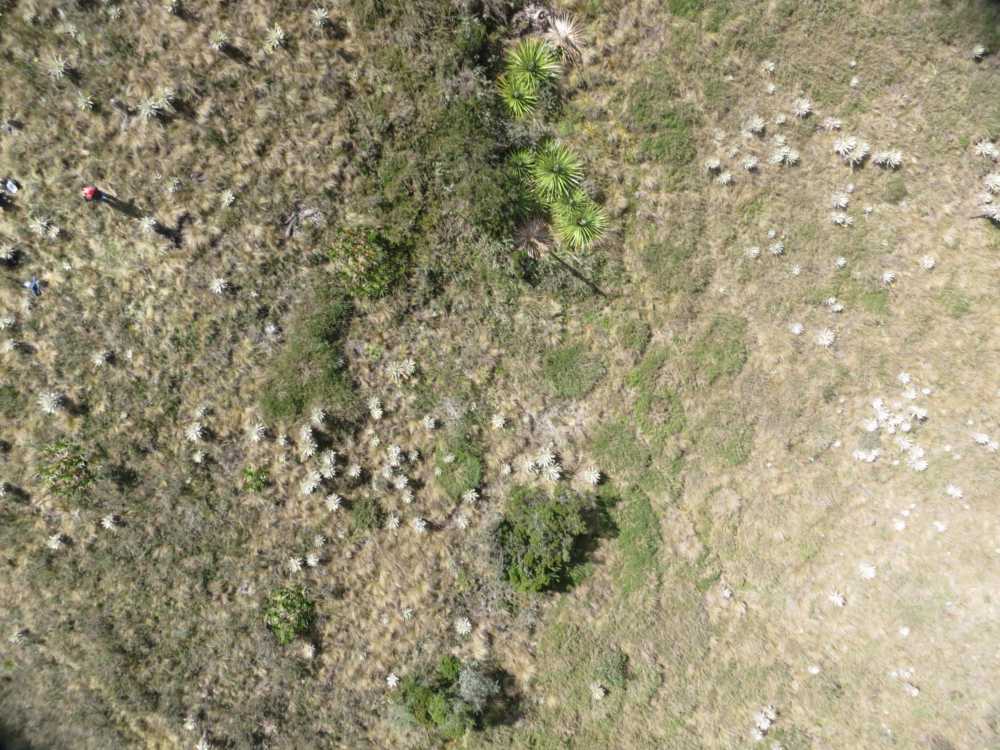

In [5]:
from tensorflow.keras.utils import load_img # import load_img from the correct module


urllib.request.urlretrieve('https://github.com/sergiomora03/AdvancedTopicsAnalytics/blob/main/notebooks/img/IMG_3451.JPG?raw=true', 'IMG_3451.JPG')
img = load_img('IMG_3451.JPG')
img

In [6]:
from ImportImagenes import *
from sklearn.model_selection import train_test_split

## Conjunto de datos

Para el entrenamiento de la red neuronal, se usará el archivo `data_F`. Debe divirse en dos grupos, conjunto de entrenamiento (CE) y conjunto de validación (CV).

Adicionalmente, fuera de las métricas del modelo, se requiere que extraiga un análisis cualitativo con la imagen `IMG_3451.JPG`, donde muestre los Frilejones detectados en el area del páramo tomado por la fotografía.

Recuerde, primero, cargamos el conjunto de datos sobre el que se va a trabajar. El siguiente código va a cargar un conjunto de datos `X` e `Y` donde `Y`es una variable binaria.

## Caso Aplicado

### Cálculo de cantidad de Frilejones

vamos a aplicar al menos 5 modelos, se estiman los siguientes valores como resultado del entrenamiento:



*   Sencilla --> 0.88
*   Multi-capa --> 0.95
*  Convolucional --> 0.95
*  Convolucional + VGG16 --> 0.99



1. Implementa una red neuronal sencilla.



2. Implementa una red neuronal multi-capa


3. Implementa una red neuronal convolucional

In [7]:
import sys

assert sys.version_info >= (3, 7)

In [8]:
from packaging import version
import sklearn

assert version.parse(sklearn.__version__) >= version.parse("1.0.1")

In [9]:
import tensorflow as tf

assert version.parse(tf.__version__) >= version.parse("2.8.0")

In [10]:
import matplotlib.pyplot as plt

plt.rc('font', size=14)
plt.rc('axes', labelsize=14, titlesize=14)
plt.rc('legend', fontsize=14)
plt.rc('xtick', labelsize=10)
plt.rc('ytick', labelsize=10)

In [11]:
import urllib
from sklearn.model_selection import train_test_split
import numpy as np

# Descargar e importar el script de imágenes
urllib.request.urlretrieve(
    'https://raw.githubusercontent.com/sergiomora03/AdvancedTopicsAnalytics/main/notebooks/img/ImportImagenesURL.py',
    'ImportImagenes.py'
)

from ImportImagenes import import_imagenes

# Cargar los datos
X, Y = import_imagenes()

# Verifica la forma original de X y Y
print("Forma original de X:", X.shape)  # (14700, 250)
print("Forma original de Y:", Y.shape)  # (1, 250)

#  Y tenga la forma correcta como un vector de etiquetas (250,)
Y = Y.reshape(-1)  #  vector de tamaño (250,)

# Dividir los datos en conjuntos de entrenamiento y validación
CE_x, CV_x, CE_y, CV_y = train_test_split(X.T, Y, test_size=0.3, random_state=100)

# Verificar las formas después del ajuste
print("CE_x shape:", CE_x.shape)  # Debería ser (175, 14700) - 175 muestras de entrenamiento
print("CE_y shape:", CE_y.shape)  # Debería ser (175,) - 175 etiquetas de entrenamiento
print("CV_x shape:", CV_x.shape)  # Debería ser (75, 14700) - 75 muestras de validación
print("CV_y shape:", CV_y.shape)  # Debería ser (75,) - 75 etiquetas de validación

# Trasponer CE_x y CV_x para que coincidan con la forma original de X
CE_x = CE_x.T
CV_x = CV_x.T


Forma original de X: (14700, 250)
Forma original de Y: (1, 250)
CE_x shape: (175, 14700)
CE_y shape: (175,)
CV_x shape: (75, 14700)
CV_y shape: (75,)


In [12]:
original_shape = int(np.sqrt(14700))  # Verifica si es un cuadrado perfecto
print(original_shape)

121


In [13]:
print(CE_x.shape, CV_x.shape, CE_y.shape, CV_y.shape)

(14700, 175) (14700, 75) (175,) (75,)


In [14]:
CE_x = CE_x.T
CV_x = CV_x.T

In [15]:
print(CE_x.shape, CV_x.shape, CE_y.shape, CV_y.shape)

(175, 14700) (75, 14700) (175,) (75,)


In [16]:
CE_x = CE_x.reshape(-1, 70, 70, 3)
CV_x = CV_x.reshape(-1, 70, 70, 3)

In [17]:
print(CE_x.shape, CV_x.shape)

(175, 70, 70, 3) (75, 70, 70, 3)


In [18]:
#Verificacion de datos
print(CE_x.shape) 
print(CV_x.shape)  
print(CE_y.shape)       
print(CV_y.shape)      

(175, 70, 70, 3)
(75, 70, 70, 3)
(175,)
(75,)


In [81]:
from functools import partial


# Establecer semilla para reproducibilidad
tf.random.set_seed(42)

# Definir una función parcial para las capas Conv2D con configuración predeterminada
DefaultConv2D = partial(tf.keras.layers.Conv2D, kernel_size=3, padding="same",
                        activation="relu", kernel_initializer="he_normal")

# Construir el modelo secuencial
model = tf.keras.Sequential([
    # Primera capa de convolución con normalización por lotes y pooling
    DefaultConv2D(filters=64, kernel_size=3, input_shape=[70, 70, 3]),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    # Segunda capa de convolución con normalización por lotes y pooling
    DefaultConv2D(filters=64, kernel_size=3),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    # Tercera capa de convolución con normalización por lotes y pooling
    DefaultConv2D(filters=128, kernel_size=3),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    # 4rta capa de convolución con normalización por lotes y pooling (si no sirve eliminar)
    DefaultConv2D(filters=128, kernel_size=3),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    # Aplanar las salidas para conectar con las capas completamente conectadas
    tf.keras.layers.Flatten(),

    # Primera capa densa con regularización L2 y Dropout
    tf.keras.layers.Dense(units=64, activation="relu", kernel_initializer="he_normal",
                          kernel_regularizer=tf.keras.regularizers.l2(0.01)),
    tf.keras.layers.Dropout(0.5),

    # Segunda capa densa con regularización L2 y Dropout
    tf.keras.layers.Dense(units=64, activation="relu", kernel_initializer="he_normal",
                          kernel_regularizer=tf.keras.regularizers.l2(0.01)),
    tf.keras.layers.Dropout(0.5),

    # Capa de salida con activación sigmoid para la clasificación binaria
    tf.keras.layers.Dense(units=1, activation="sigmoid")
])

C:\Users\David Avila\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [83]:
# Compilar el modelo
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss='binary_crossentropy',
              metrics=['accuracy',tf.keras.metrics.AUC(name='auc')])

# Definir callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

# Entrenar el modelo
history = model.fit(CE_x, CE_y, epochs=50, batch_size=8,
                    validation_data=(CV_x, CV_y),
                    callbacks=[early_stopping])

loss, accuracy, auc = model.evaluate(CV_x, CV_y)
print(f'Pérdida: {loss:.4f}')
print(f'Precisión: {accuracy:.4f}')
print(f'AUC: {auc:.4f}')

Epoch 1/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 4s 59ms/step - accuracy: 0.9531 - auc: 0.9993 - loss: 1.7313 - val_accuracy: 0.8933 - val_auc: 0.9335 - val_loss: 2.1163
Epoch 2/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.9860 - auc: 0.9989 - loss: 1.6414 - val_accuracy: 0.8933 - val_auc: 0.9491 - val_loss: 1.9385
Epoch 3/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.9609 - auc: 0.9971 - loss: 1.6180 - val_accuracy: 0.8933 - val_auc: 0.9648 - val_loss: 1.8978
Epoch 4/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.9990 - auc: 1.0000 - loss: 1.5314 - val_accuracy: 0.9067 - val_auc: 0.9419 - val_loss: 2.0810
Epoch 5/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.9955 - auc: 0.9990 - loss: 1.4948 - val_accuracy: 0.9067 - val_auc: 0.9364 - val_loss: 2.2106
Epoch 6/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 1.0000 - auc: 1.0000 - loss: 1.4385 - val_accuracy: 0.9200 - val_auc: 0.9462 - val_loss: 1.9654
Epoch 7/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 1

3.1 Optimizacion con optuna

In [94]:
import optuna
import tensorflow as tf
from functools import partial
import numpy as np

# Definir la función parcial para las capas Conv2D con configuración predeterminada
DefaultConv2D = partial(tf.keras.layers.Conv2D, kernel_size=3, padding="same",
                        activation="relu", kernel_initializer="he_normal")

# Definir la función objetivo para Optuna
def objective(trial):
    # Definir hiperparámetros para optimizar
    filters_1 = trial.suggest_int('filters_1', 32, 128)
    filters_2 = trial.suggest_int('filters_2', 32, 128)
    filters_3 = trial.suggest_int('filters_3', 64, 256)
    filters_4 = trial.suggest_int('filters_4', 64, 256)
    dense_units_1 = trial.suggest_int('dense_units_1', 32, 128)
    dense_units_2 = trial.suggest_int('dense_units_2', 32, 128)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.3, 0.7)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-1)

    # Construir el modelo secuencial
    model = tf.keras.Sequential([
        # Primera capa de convolución con normalización por lotes y pooling
        DefaultConv2D(filters=filters_1, input_shape=[70, 70, 3]),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

        # Segunda capa de convolución con normalización por lotes y pooling
        DefaultConv2D(filters=filters_2),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

        # Tercera capa de convolución con normalización por lotes y pooling
        DefaultConv2D(filters=filters_3),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

        # Cuarta capa de convolución con normalización por lotes y pooling
        DefaultConv2D(filters=filters_4),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

        # Aplanar las salidas para conectar con las capas completamente conectadas
        tf.keras.layers.Flatten(),

        # Primera capa densa con regularización L2 y Dropout
        tf.keras.layers.Dense(units=dense_units_1, activation="relu", kernel_initializer="he_normal",
                              kernel_regularizer=tf.keras.regularizers.l2(0.01)),
        tf.keras.layers.Dropout(dropout_rate),

        # Segunda capa densa con regularización L2 y Dropout
        tf.keras.layers.Dense(units=dense_units_2, activation="relu", kernel_initializer="he_normal",
                              kernel_regularizer=tf.keras.regularizers.l2(0.01)),
        tf.keras.layers.Dropout(dropout_rate),

        # Capa de salida con activación sigmoid para la clasificación binaria
        tf.keras.layers.Dense(units=1, activation="sigmoid")
    ])

    # Compilar el modelo
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])

    # Entrenar el modelo
    history = model.fit(CE_x, CE_y, epochs=50, batch_size=8,  # Utiliza epochs y batch_size pequeños para pruebas rápidas
                        validation_data=(CV_x, CV_y),
                        verbose=0)  # Cambia verbose a 1 para ver el progreso

    # Evaluar el modelo
    loss, accuracy, auc = model.evaluate(CV_x, CV_y, verbose=0)

    # Combinar las métricas en una sola
    alpha = 0.5
    beta = 0.5
    combined_score = alpha * auc + beta * accuracy

    return combined_score


In [95]:
# Crear un estudio de Optuna
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)  # Ajusta el número de pruebas según tus necesidades

# Mostrar los mejores hiperparámetros
print('Mejores hiperparámetros:', study.best_params)
print('Mejor métrica combinada:', study.best_value)

[I 2024-09-03 11:40:56,188] A new study created in memory with name: no-name-2703e957-5d87-4358-905d-aaafc3b12fb7
[I 2024-09-03 11:41:54,337] Trial 0 finished with value: 0.8391206562519073 and parameters: {'filters_1': 90, 'filters_2': 61, 'filters_3': 76, 'filters_4': 129, 'dense_units_1': 72, 'dense_units_2': 81, 'dropout_rate': 0.5726110870593368, 'learning_rate': 0.02521814906890967}. Best is trial 0 with value: 0.8391206562519073.
[I 2024-09-03 11:43:07,192] Trial 1 finished with value: 0.914326548576355 and parameters: {'filters_1': 86, 'filters_2': 106, 'filters_3': 164, 'filters_4': 221, 'dense_units_1': 98, 'dense_units_2': 122, 'dropout_rate': 0.6509982491600599, 'learning_rate': 1.2006899384313504e-05}. Best is trial 1 with value: 0.914326548576355.
[I 2024-09-03 11:43:47,336] Trial 2 finished with value: 0.8547044694423676 and parameters: {'filters_1': 53, 'filters_2': 34, 'filters_3': 193, 'filters_4': 115, 'dense_units_1': 67, 'dense_units_2': 60, 'dropout_rate': 0.61057

Mejores hiperparámetros: {'filters_1': 118, 'filters_2': 84, 'filters_3': 156, 'filters_4': 146, 'dense_units_1': 123, 'dense_units_2': 37, 'dropout_rate': 0.5079153648495992, 'learning_rate': 0.00159039859750974}
Mejor métrica combinada: 0.9623062014579773


In [99]:


# Establecer semilla para reproducibilidad
tf.random.set_seed(42)


DefaultConv2D = partial(tf.keras.layers.Conv2D, kernel_size=3, padding="same",
                        activation="relu", kernel_initializer="he_normal")


model = tf.keras.Sequential([
    # Primera capa de convolución con normalización por lotes y pooling
    DefaultConv2D(filters=118, kernel_size=3, input_shape=[70, 70, 3]),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    # Segunda capa de convolución con normalización por lotes y pooling
    DefaultConv2D(filters=84, kernel_size=3),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    # Tercera capa de convolución con normalización por lotes y pooling
    DefaultConv2D(filters=156, kernel_size=3),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    # 4rta capa de convolución con normalización por lotes y pooling 
    DefaultConv2D(filters=37, kernel_size=3),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    # Aplanar las salidas para conectar con las capas completamente conectadas
    tf.keras.layers.Flatten(),

    # Primera capa densa con regularización L2 y Dropout
    tf.keras.layers.Dense(units=123, activation="relu", kernel_initializer="he_normal",
                          kernel_regularizer=tf.keras.regularizers.l2(0.01)),
    tf.keras.layers.Dropout(0.5),

    # Segunda capa densa con regularización L2 y Dropout
    tf.keras.layers.Dense(units=77, activation="relu", kernel_initializer="he_normal",
                          kernel_regularizer=tf.keras.regularizers.l2(0.01)),
    tf.keras.layers.Dropout(0.5),

    # Capa de salida con activación sigmoid para la clasificación binaria
    tf.keras.layers.Dense(units=1, activation="sigmoid")
])

# Compilar el modelo
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00159039859750974),
              loss='binary_crossentropy',
              metrics=['accuracy',tf.keras.metrics.AUC(name='auc')])

# Definir callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

# Entrenar el modelo
history = model.fit(CE_x, CE_y, epochs=100, batch_size=8,
                    validation_data=(CV_x, CV_y),
                    callbacks=[early_stopping])

loss, accuracy, auc = model.evaluate(CV_x, CV_y)
print(f'Pérdida: {loss:.4f}')
print(f'Precisión: {accuracy:.4f}')
print(f'AUC: {auc:.4f}')

Epoch 1/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.5850 - auc: 0.6168 - loss: 5.1979 - val_accuracy: 0.4267 - val_auc: 0.5000 - val_loss: 11.9198
Epoch 2/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.8235 - auc: 0.8930 - loss: 4.1797 - val_accuracy: 0.4267 - val_auc: 0.6047 - val_loss: 8.2312
Epoch 3/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - accuracy: 0.8107 - auc: 0.9089 - loss: 3.8590 - val_accuracy: 0.4400 - val_auc: 0.6163 - val_loss: 8.5811
Epoch 4/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - accuracy: 0.8394 - auc: 0.8934 - loss: 3.8331 - val_accuracy: 0.8667 - val_auc: 0.8997 - val_loss: 3.5712
Epoch 5/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.8590 - auc: 0.9589 - loss: 3.3310 - val_accuracy: 0.8533 - val_auc: 0.8801 - val_loss: 3.4470
Epoch 6/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.9182 - auc: 0.9771 - loss: 3.0707 - val_accuracy: 0.8400 - val_auc: 0.9012 - val_loss: 3.2541
Epoch 7/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━

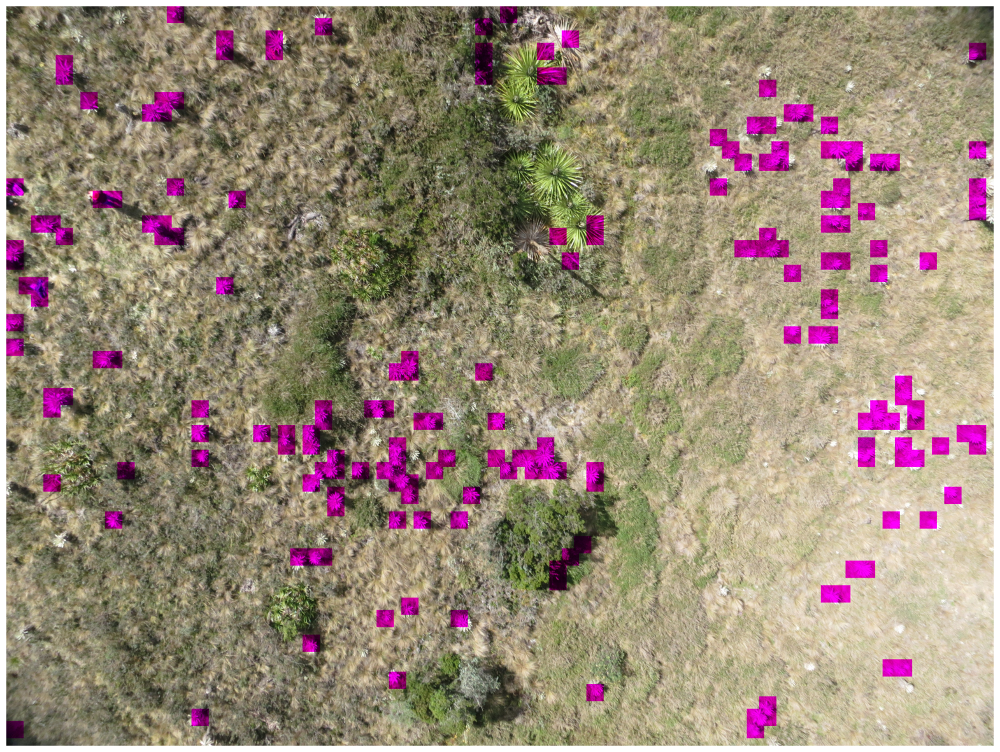

In [100]:
x = np.array(img, dtype=np.float32) / 255.0 
x2 = x.copy() 
 

patch_size = 70
step_size = 50
 
ni = x.shape[0] - patch_size + 1  
mi = x.shape[1] - patch_size + 1  

 

for f1 in range(0, ni, step_size):
    for c1 in range(0, mi, step_size):
        
        f2 = min(f1 + patch_size, x.shape[0])  
        c2 = min(c1 + patch_size, x.shape[1])  
        subi = x[f1:f2, c1:c2, :]

        
        subi_reshaped = subi.reshape(1, patch_size, patch_size, 3)

       
        #subi_preprocessed = preprocess_images(subi_reshaped,(70, 70))

       
        pred_P = model.predict(subi_reshaped)

       
        pred_P = (pred_P > 0.5).astype(int)

       
        if pred_P[0] == 1:
            
            x2[f1:f2, c1:c2, 1] = 0 

# imagen modificada
plt.figure(figsize=(20, 20))
plt.imshow(x2)
plt.axis('off') 
plt.show()


5. Implementa una red neuronal convolucional con tranferencia VGG-16 y ajuste de hiperparámetros (bono por uso de Optuna).






6. Responda: **¿Qué puede observar sobre el desempeño de los diferentes modelos? Argumente cuál es el mejor modelo para poner en producción.**

7. Investigue otra red pre-entrenada dsitinta a la VGG-16 e implemente el aprendizaje por transferencia para la deteccion de frailejones. Argumente por qué su justifica el aprendizaje por transferencia con base en el modelo pre-entrenado de su elección (cómo se relacionan la tarea base y la segunda tarea objetivo).


Para la detección de frailejones, he utilizado la arquitectura ResNet-50 como modelo preentrenado para aplicar aprendizaje por transferencia. Este enfoque se justifica debido a que ResNet-50 ha sido entrenado previamente en un conjunto de datos extenso como ImageNet, que incluye millones de imágenes con diversas categorías, lo que permite que el modelo aprenda características genéricas de bajo nivel, como bordes, texturas y formas.

En el caso de la detección de frailejones, aunque es una tarea específica y diferente de la clasificación general de ImageNet, la naturaleza visual de ambas tareas es comparable. Las primeras capas de ResNet-50 capturan características generales de las imágenes, mientras que las últimas capas pueden ser adaptadas para la tarea específica de clasificación binaria de frailejones. Esto evita entrenar desde cero, lo cual requeriría más datos y tiempo de cómputo, mejorando la eficiencia y precisión.

In [20]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.optimizers import Adam

# Cargar el modelo pre-entrenado ResNet-50
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(70, 70, 3))

# Congelar todas las capas del modelo base inicialmente
for layer in base_model.layers:
    layer.trainable = False

# Añadir nuevas capas personalizadas
x = base_model.output
x = GlobalAveragePooling2D()(x)  # Promedio global para reducir dimensiones
x = Dense(2048, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)  # Aumentar el número de neuronas
x = Dropout(0.2)(x)  # Dropout para evitar sobreajuste
x = Dense(1024, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)  # Capa densa adicional
x = Dropout(0.2)(x)  # Dropout adicional
x = Dense(1, activation='sigmoid')(x)  # Capa de salida para clasificación binaria

# Crear el modelo final
model = Model(inputs=base_model.input, outputs=x)

# Descongelar las últimas capas del modelo base
for layer in base_model.layers[-10:]:  # Descongelar las últimas 10 capas, por ejemplo
    layer.trainable = True

# Configurar el optimizador con un learning rate reducido
optimizer = Adam(learning_rate=1e-5)  # Prueba con una tasa de aprendizaje más baja para el fine-tuning

# Compilar el modelo
model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy', 'AUC'])


# Entrenamiento del modelo
history = model.fit(CE_x, CE_y, validation_data=(CV_x, CV_y), epochs=200, batch_size=8)

# Evaluación del modelo
loss, accuracy, auc = model.evaluate(CV_x, CV_y)
print(f'Precisión: {accuracy:.2f}')
print(f'AUC: {auc:.2f}')


Epoch 1/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 11s 228ms/step - AUC: 0.5293 - accuracy: 0.5151 - loss: 34.7329 - val_AUC: 0.4019 - val_accuracy: 0.5733 - val_loss: 34.4083
Epoch 2/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 155ms/step - AUC: 0.7358 - accuracy: 0.6372 - loss: 34.2091 - val_AUC: 0.5756 - val_accuracy: 0.5733 - val_loss: 33.9887
Epoch 3/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 152ms/step - AUC: 0.7228 - accuracy: 0.6829 - loss: 33.8121 - val_AUC: 0.6457 - val_accuracy: 0.5733 - val_loss: 33.5826
Epoch 4/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 153ms/step - AUC: 0.8144 - accuracy: 0.7456 - loss: 33.3502 - val_AUC: 0.6824 - val_accuracy: 0.5733 - val_loss: 33.1756
Epoch 5/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 4s 160ms/step - AUC: 0.8478 - accuracy: 0.7633 - loss: 32.9201 - val_AUC: 0.7086 - val_accuracy: 0.5733 - val_loss: 32.7782
Epoch 6/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 143ms/step - AUC: 0.8855 - accuracy: 0.8038 - loss: 32.4763 - val_AUC: 0.7678 - val_accuracy: 0.5733 - val_loss: 32.3833
Epoch 7/200
22/22 ━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━

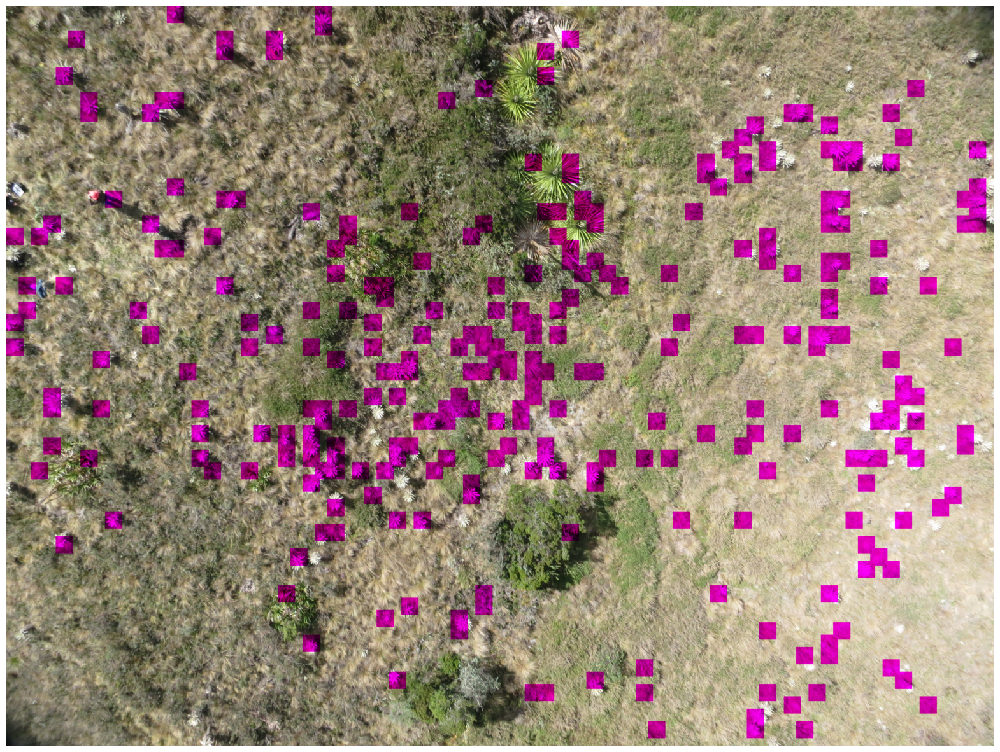

In [21]:
x = np.array(img, dtype=np.float32) / 255.0 
x2 = x.copy() 
 

patch_size = 70
step_size = 50
 
ni = x.shape[0] - patch_size + 1  
mi = x.shape[1] - patch_size + 1  

 

for f1 in range(0, ni, step_size):
    for c1 in range(0, mi, step_size):
        
        f2 = min(f1 + patch_size, x.shape[0])  
        c2 = min(c1 + patch_size, x.shape[1])  
        subi = x[f1:f2, c1:c2, :]

        
        subi_reshaped = subi.reshape(1, patch_size, patch_size, 3)

       
        #subi_preprocessed = preprocess_images(subi_reshaped,(70, 70))

       
        pred_P = model.predict(subi_reshaped)

       
        pred_P = (pred_P > 0.5).astype(int)

       
        if pred_P[0] == 1:
            
            x2[f1:f2, c1:c2, 1] = 0 

# imagen modificada
plt.figure(figsize=(20, 20))
plt.imshow(x2)
plt.axis('off') 
plt.show()

### Cálculo de densidad poblacional por grupos de Frilejones

Iniciaremos con el cálculo total de frilejones en la imagen y con ello (de acuerdo con la ayuda) tendrémos la densidad de frilejones. Para ello únicamente correremos el loop nuevamente y cambiaremos un poco sus parametros para contar el número exacto de frilejones en la imagen.

NOTA: aprovecharemos también para sacar la ubicaciónd de cada frilejon simulando "latitud y longitud". Como se muestra en la siguiente imagen:


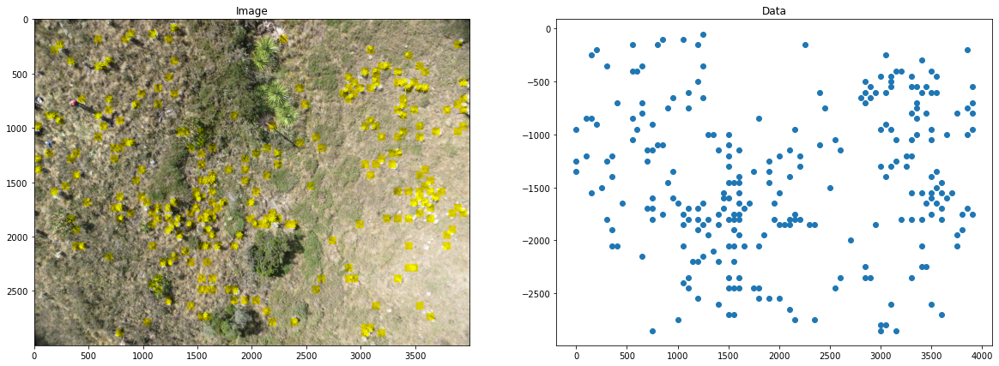


Una vez calculada la cantidad total de frilejones en la imagen, debe hacer el cálculo de la densidad poblacional. Se recomienda el uso de un GMM o puede aplicar algún análisis, heurística que identifique los grupos de frilejosnes en la imagen y la densidad en cada grupo.